# Airbnb Sentiment Analysis
## by Om Thapa, for Data Analytics TTEC605

### Summary of the analysis
This analysis used two datasets `listings.csv` and `reviews.csv`. 
- Prliminary data exploring done on `listings.csv` to understand general sentiment of the listings. 
- Data cleaning: i.e removing empty cells
- Initial word cloud generated to gain an overview of the reviews.
- Sentiment analysis using VADER and produce negative and positive sentiment dataframe
- Generate word clouds of negative and positive sentiments. Bar plots of most frequent word for negative sentiment showed that most non-english reviews are marked as negative sentiments
- Data cleaning again: use of `langdetect` library to filter out english reviews
- Performed sentiment analysis on CLEANED data and generate a refined dataset
- Logsitic regression is used to train a model using the refined labeled dataset
  (Vectorised the `review` column and `sentiment` are labeled target for model training)
- Topic Modelling using LDA and NMF

Note: Splitting dataset code is on 4th cell



In [1]:
import pandas as pd

# Import the listings dataset to view the overall rating of listings
df_listings = pd.read_csv('Datasets/listings.csv')
print(df_listings.shape)
df_listings.head()

(39670, 106)


/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3508: DtypeWarning: Columns (43,61,62,94) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,listing_id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,11156,https://www.airbnb.com/rooms/11156,2.020030e+13,16/3/20,An Oasis in the City,Very central to the city which can be reached ...,Potts Pt. is a vibrant and popular inner-city...,Very central to the city which can be reached ...,none,"It is very close to everything and everywhere,...",...,f,f,moderate,f,f,1,0,1,0,1.55
1,12351,https://www.airbnb.com/rooms/12351,2.020030e+13,16/3/20,Sydney City & Harbour at the door,Come stay with Vinh & Stuart (Awarded as one o...,"We're pretty relaxed hosts, and we fully appre...",Come stay with Vinh & Stuart (Awarded as one o...,none,"Pyrmont is an inner-city village of Sydney, on...",...,f,f,strict_14_with_grace_period,t,t,2,0,2,0,4.48
2,14250,https://www.airbnb.com/rooms/14250,2.020030e+13,17/3/20,Manly Harbour House,"Beautifully renovated, spacious and quiet, our...",Our home is a thirty minute walk along the sea...,"Beautifully renovated, spacious and quiet, our...",none,Balgowlah Heights is one of the most prestigio...,...,f,f,strict_14_with_grace_period,f,f,2,2,0,0,0.04
3,15253,https://www.airbnb.com/rooms/15253,2.020030e+13,16/3/20,Unique Designer Rooftop Apartment in City Loca...,Penthouse living at it best ... You will be st...,"A charming two-level, two-bedroom, two-bathroo...",Penthouse living at it best ... You will be st...,none,The location is really central and there is nu...,...,t,f,strict_14_with_grace_period,f,f,2,1,1,0,3.68
4,44545,https://www.airbnb.com/rooms/44545,2.020030e+13,16/3/20,Sunny Darlinghurst Warehouse Apartment,Sunny warehouse/loft apartment in the heart of...,"My apartment is a beautiful, simple, open plan...",Sunny warehouse/loft apartment in the heart of...,none,Darlinghurst is home to some of Sydney's best ...,...,f,f,strict_14_with_grace_period,f,t,1,1,0,0,0.66


In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
%matplotlib inline
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.express as px
import collections

# Plot histogram of the Review scores rating column
fig = px.histogram(df_listings, x="review_scores_rating")
fig.update_traces(marker_color="pink",marker_line_color='rgb(72,72,72)',
                  marker_line_width=1)
fig.update_layout(title_text='Overall Listing Histogram Ratings')
fig.show()


<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [3]:
# Summary stats of the overall ratings

print("Mean: ", df_listings["review_scores_rating"].mean())
print("Median: ", df_listings["review_scores_rating"].median())
# print("Mode: ", df_listings["review_scores_rating"].mode())
print("Standrd Deviation: ", df_listings["review_scores_rating"].std())

Mean:  93.07560296846012
Median:  96.0
Standrd Deviation:  10.42014044922026


### Preliminary data exploration: word cloud and bar plot
This shows the histogram of the 'review_scores_rating' column. Every listing has 5 dimensions of such as Cleaniness, Accuracy, Communcation, Location, Check-in and Value. Instead we will be plotting the over rating which are scored out of 5. Our dataset shows that, the rating are scaled to 100. 


Most of the listings ratings are positive except for the outliers of 147 ratings with 20/100 ratings. The mean scoring is 93.075/100 with standard deviation of 10.42

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/omslaww/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


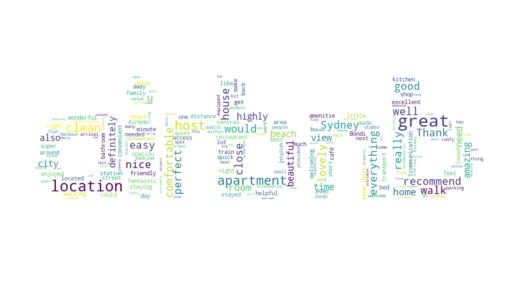

In [4]:
from wordcloud import WordCloud
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
import numpy as np
from PIL import Image

# Import the reviews dataset which contains the customers's reviews
df_reviews = pd.read_csv('Datasets/reviews.csv')
df_reviews.dropna() # Data cleaning removing empty cells

# df_reviews = df_reviews.iloc[:10000] # Slice the dataframe

# Convert the comments column to string and normalise them to lowercase
df_reviews['comments'] = df_reviews['comments'].astype(str)
# df_reviews['comments'] = df_reviews['comments'].str.lower()

# Create stopword list
stopwords = set(stopwords.words(['english']))
stopwords.update(['place', 'stay'])
text = " ".join(review for review in df_reviews.comments)

# Create word cloud
mask = np.array(Image.open("airbnb.jpeg"))
wordcloud = WordCloud(
            stopwords=stopwords,
#             width=1600,
#             height=800,
            random_state=21,
#             max_font_size=110,
            background_color="white",
            collocations=False,
            mask=mask
        ).generate(text)
# wordcloud = WordCloud(stopwords=stopwords).generate(text)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud_reviews.png', dpi=300)
plt.show()

### Most frequent words bar plot
This is to extract out the most frequent words used in the review

In [5]:
def convert(lst): 
    return ([i for item in lst for i in item.lower().split()]) 


all_words_review = convert(df_reviews['comments']) 
count_word = collections.Counter(all_words_review) # Count word frequency

# all_words_review = convert(df_reviews['comments'].fillna("")) #Fill in missing reviews with blank
# count_word = collections.Counter(all_words_review) #Count word frequency

clean_word_count = pd.DataFrame(count_word.most_common(5),
                             columns=['words', 'count'])

clean_word_count.head()
list(stopwords)[0:10]

words_review_cleaned = [word for word in all_words_review if word not in stopwords]
words_review_count = collections.Counter(words_review_cleaned)

word_review_count_df = pd.DataFrame(words_review_count.most_common(15),
                             columns=['words', 'count'])

In [6]:
# Plot histogram of the Review scores rating column
fig = px.bar(word_review_count_df, x="words", y="count")
fig.update_traces(marker_color="rgb(252,100,45)")
fig.update_layout(title_text="Most Frequent Words (All Review)")

fig.show()

### Explore Listing Demographics
We would like to find out the how many listings are from each state in Australia

In [7]:
# Perform counting from the listing.csv file and count 'state' column

def convert(lst): 
    return ([i for item in lst for i in item.lower().split()]) 

df_listings['state'] = df_listings['state'].astype(str)
all_states = convert(df_listings['state'])
count_state = collections.Counter(all_states) # Count state frequency

clean_state_count = pd.DataFrame.from_records(list(count_state.items()), columns=['state', 'count'])

clean_state_count.head()

,state,count
0,nsw,38679
1,sydney,9
2,new,908
3,south,907
4,wales,906


In [8]:
# Plot histogram of the Review scores rating column
fig = px.bar(clean_state_count, x="state", y="count")
fig.update_traces(marker_color="rgb(226,0,163)")
fig.update_layout(title_text="Listing States")

fig.show()

### Short remarks
It looks like most of the listings are in the dataset are from New South Wales(NSW), Austrlia. The sentiment findings will be applicable to NSW only

### Sentiment Analysis with VADER
Now we perform sentiment analaysis using VADER, each reviews will have a negative, neutral, positive and compound dimensions.
These values will be then added to the `df_reviews` dataframe.

In [9]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
sid = SentimentIntensityAnalyzer()

In [10]:
df_reviews[['neg', 'neu', 'pos', 'compound']] = df_reviews['comments'].apply(sid.polarity_scores).apply(pd.Series)
df_reviews.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments,neg,neu,pos,compound
0,11156,19220,2009-12-05,52946,Jeff,Colleen was friendly and very helpful regardin...,0.0,0.814,0.186,0.9402
1,11156,32592,2010-03-31,99382,Michael,"Great place, centrally located, easy walk to t...",0.0,0.595,0.405,0.9359
2,11156,42280,2010-05-14,105797,Marina,Colleen is very friendly and helpful. The apar...,0.0,0.517,0.483,0.8540
3,11156,140942,2010-11-17,259213,Sigrid,Dear Colleen!\r\nMy friend Diemut from Germany...,0.0,0.604,0.396,0.9831
4,11156,151966,2010-12-11,273389,Eduardo,"Lovely, interesting chats and very helpful giv...",0.0,0.656,0.344,0.9282


### Categorising positive and negative sentiment 
Compound value > 1 will be positive sentiment and compound value < 1 will be negative sentiment
Will remove compound value of 0 from the dataframe since they will be useful in further analysis

In [11]:
df_reviews = df_reviews[df_reviews['compound'] != 0]
df_reviews['sentiment'] = df_reviews['compound'].apply(lambda rating : +1 if rating > 0 else -1)

Becase it is unclear what the null comment should be, it is natural to drop these rows:

In [12]:
df_reviews.comments.isnull().sum()

0

In [13]:
print("negative samples:",len(df_reviews[df_reviews["sentiment"]== -1]))
print("postitive samples:",len(df_reviews[df_reviews["sentiment"]== 1]))

negative samples: 11884
postitive samples: 588147


### Extract the english reviews only
`langdetect` to filter out non-english
Note: If performed on the full dataset, it takes extremly long as it linear detects the language on each row,
hence for testing, split the dataset above.

In [14]:
from langdetect import detect

def detect_lang(text):
   try:
       return detect(text)
   except:
       pass

df_reviews['lang'] = df_reviews['comments'].apply(detect_lang)
print('Size of the dataframe before removing non-english languages: ',df_reviews.shape)

# Filter out the english reviews only
df_reviews = df_reviews[df_reviews['lang'] == 'en']
print('Size of the dataframe after removing non-english languages: ',df_reviews.shape)

Size of the dataframe before removing non-english languages:  (600031, 12)
Size of the dataframe after removing non-english languages:  (584018, 12)


### Split the positive and negative sentiment into two seprate dataframe and export as csv

In [15]:
# Split the positive and negative sentiment
positive = df_reviews[df_reviews['sentiment'] == 1]
negative = df_reviews[df_reviews['sentiment'] == -1]

# Export the positive and negative reviews to csv

positive.to_csv("positive.csv")
negative.to_csv("negative.csv")

### Positive word clouds and frequent words bar plot
Now the positive and negative are split, create a wordcloud for positive words and bar plot of the most frequent words that are positive sentiments

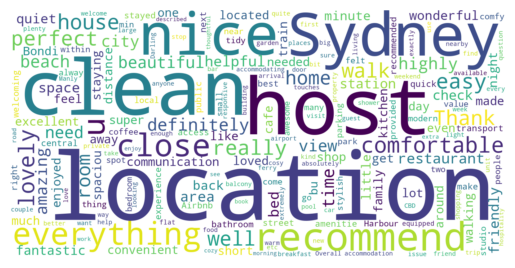

In [16]:
# stopwords = set(STOPWORDS)

stopwords.update(["br", "href","good","great", "place", "stay", "also", "apartment", "could", "would", '-'])

# Place and stay excluded from the wordcloud since they are used a description words
# good and great removed because they were included in negative sentiment

pos = " ".join(str(review) for review in positive.comments)
wordcloud2 = WordCloud(
            stopwords=stopwords,
            width=1600,
            height=800,
            random_state=21,
#             max_font_size=110,
            background_color="white",
            collocations=False,
        ).generate(pos)
plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloudq_positive.png', dpi=300)
plt.show()

In [17]:
# Common words in positive sentiment

def convert(lst): 
    return ([i for item in lst for i in item.lower().split()]) 

all_words_review = convert(positive['comments'].fillna("")) #Fill in missing reviews with blank
count_word = collections.Counter(all_words_review) #Count word frequency

clean_word_count = pd.DataFrame(count_word.most_common(5),
                             columns=['words', 'count'])

clean_word_count.head()
list(stopwords)[0:10]

words_review_cleaned = [word for word in all_words_review if word not in stopwords]
words_review_count = collections.Counter(words_review_cleaned)

word_review_count_df = pd.DataFrame(words_review_count.most_common(15),
                             columns=['words', 'count'])

In [18]:
# Plot histogram of the Review scores rating column
fig = px.bar(word_review_count_df, x="words", y="count")
fig.update_traces(marker_color="rgb(0,166,152)")
fig.update_layout(title_text="Most Frequent Words (Positive Sentiment)")

fig.show()

### Negative word clouds and frequent words bar plot
We do the same for negative words

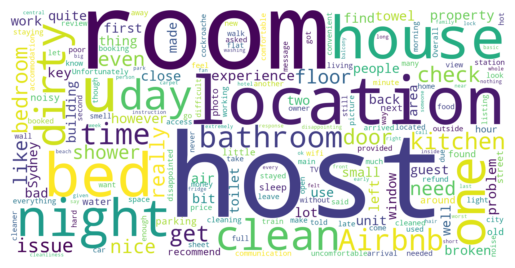

In [19]:
# Creating wordcloud for negetive comments

neg = " ".join(str(review) for review in negative.comments)
wordcloud3 = WordCloud(
            stopwords=stopwords,
            width=1600,
            height=800,
            random_state=21,
#             max_font_size=110,
            background_color="white",
            collocations=False,
        ).generate(neg)
plt.imshow(wordcloud3, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud_negative.png', dpi=300)
plt.show()

In [20]:
# Common words in positive sentiment

def convert(lst): 
    return ([i for item in lst for i in item.lower().split()]) 

all_words_review = convert(negative['comments'].fillna("")) #Fill in missing reviews with blank
count_word = collections.Counter(all_words_review) #Count word frequency

clean_word_count = pd.DataFrame(count_word.most_common(5),
                             columns=['words', 'count'])

clean_word_count.head()
list(stopwords)[0:10]

words_review_cleaned = [word for word in all_words_review if word not in stopwords]
words_review_count = collections.Counter(words_review_cleaned)

word_review_count_df = pd.DataFrame(words_review_count.most_common(15),
                             columns=['words', 'count'])

In [21]:
# Plot histogram of the Review scores rating column
fig = px.bar(word_review_count_df, x="words", y="count")
fig.update_traces(marker_color="rgb(255,90,95)")
fig.update_layout(title_text="Most Frequent Words (Negative Sentiment)")

fig.show()

The wordcloud from the negative sentiment datasets shows words that are not in english language but uses the english alphabhets. It looks like we have reviews written in other languages. Since we want to focus on the reviews of english language only, we will filter out the non english reviews using `langdetect` library

In [22]:
# Finaly, we can take a look at the distribution of reviews with sentiment across the dataset

df_reviews.head()
df_reviews['sentimentt'] = df_reviews['sentiment'].replace({-1 : 'negative'})
df_reviews['sentimentt'] = df_reviews['sentimentt'].replace({1 : 'positive'})
fig = px.histogram(df_reviews, x="sentimentt")
fig.update_traces(marker_color="rgb(255,90,95)",marker_line_color='rgb(0,166,153)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Reviews Sentiment')
plt.savefig("reviews_sentiment.png", dpi=300)
fig.show()

new_refined_df = df_reviews
new_refined_df.to_csv("refined.csv")

# c = (new_refined_df['comments'] == '').sum()
# print(c)

<Figure size 640x480 with 0 Axes>

### Short remarks about the graph
It looks like the general sentiment or the reviews on the listings are very positive.

## Data prepration for training a machine learning model

In [23]:
# Building a model
def remove_punctuation(text):
    final = "".join(u for u in text if u not in ("?", ".", ";", ":",  "!",'"'))
    return final

df_reviews['comments'] = df_reviews['comments'].apply(remove_punctuation)
# df_reviews[df_reviews['comments'].astype(bool)] # Removing empty cells under the comments section

In [24]:
c = (negative['comments'] == '').sum()
print(c) # Check to see if there is empty cells in a column

0


In [25]:
df_New = df_reviews[["comments", "sentiment"]]
df_New.head()

,comments,sentiment
0,Colleen was friendly and very helpful regardin...,1
1,"Great place, centrally located, easy walk to t...",1
2,Colleen is very friendly and helpful The apart...,1
3,Dear Colleen\r\nMy friend Diemut from Germany ...,1
4,"Lovely, interesting chats and very helpful giv...",1


### Splitting the dataset into 80/20
We will now split the data frame into train and test sets. 
80% of the data will be used for training, and 20% will be used for testing.
random split train and test data

In [26]:
import numpy as np
index = df_reviews.index
df_reviews['random_number'] = np.random.randn(len(index))
train = df_reviews[df_reviews['random_number'] <= 0.8]
test = df_reviews[df_reviews['random_number'] > 0.8]

In [27]:
# count vectorizer:

from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(token_pattern=r'\b\w+\b')
train_matrix = vectorizer.fit_transform(train['comments'])
test_matrix = vectorizer.transform(test['comments'])

### Logistic Regression will be used to train the model

In [28]:
# Logistic Regression

from sklearn.linear_model import LogisticRegression
lr = LogisticRegression()

# Split target and independent variables

X_train = train_matrix
X_test = test_matrix
y_train = train['sentiment']
y_test = test['sentiment']

In [29]:
# Fit model on data


lr.fit(X_train,y_train)

/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression()

In [30]:
# Make predictions:


predictions = lr.predict(X_test)

### Testing

Now, we can test the accuracy of our model! In a form of a confusion Matrix

In [31]:
# find accuracy, precision, recall:


from sklearn.metrics import confusion_matrix,classification_report
new = np.asarray(y_test)
confusion_matrix(predictions,y_test)

array([[   864,    333],
       [   829, 121752]])

In [32]:
# The classification report:
print(classification_report(predictions,y_test))

              precision    recall  f1-score   support

          -1       0.51      0.72      0.60      1197
           1       1.00      0.99      1.00    122581

    accuracy                           0.99    123778
   macro avg       0.75      0.86      0.80    123778
weighted avg       0.99      0.99      0.99    123778



### Results Summary
The overall accuray is very high, of 99%.
The precision and recall for prediction negative sentiment is fairly low, while the precision and recall for prediction positive sentiment is very high. 

This results is consistent with our inial data exploration since the dataset consists of positive sentiemnts. The model may have been overfitted with positive sentiment since, it trained on mostly positive sentiments.

The model accuray can be fine tuned with feature engineering or gather more data (that consists of negative sentiments) to reduce the overfitting. 

## Topic Modelling

In [33]:
# We will be using our refined and cleaned dataset
dataset = 'refined.csv'
reviews_datasets = pd.read_csv(dataset)

/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3508: DtypeWarning:

Columns (0,7) have mixed types.Specify dtype option on import or set low_memory=False.



### We will be applying LDA on the "comments" column since it contains the reviews, the rest of the columns will be ignored.

In [34]:
#Drop the columns that will not be used
reviews_datasets.drop(['neg', 'neu', 'pos', 'compound', 'sentiment', 'sentimentt', 'lang'], axis=1, inplace=True)

print('Before removing empty cells: ', reviews_datasets.shape)

reviews_datasets = reviews_datasets.head(20000)
reviews_datasets.dropna() # Data cleaning removing empty data values

print('After removing empty cells: ', reviews_datasets.shape)

Before removing empty cells:  (584019, 7)
After removing empty cells:  (20000, 7)


In [35]:
reviews_datasets.head() # Priview of the datatset

,Unnamed: 0,listing_id,id,date,reviewer_id,reviewer_name,comments
0,0,11156.0,19220.0,2009-12-05,52946.0,Jeff,Colleen was friendly and very helpful regardin...
1,1,11156.0,32592.0,2010-03-31,99382.0,Michael,"Great place, centrally located, easy walk to t..."
2,2,11156.0,42280.0,2010-05-14,105797.0,Marina,Colleen is very friendly and helpful. The apar...
3,3,11156.0,140942.0,2010-11-17,259213.0,Sigrid,Dear Colleen!\r\nMy friend Diemut from Germany...
4,4,11156.0,151966.0,2010-12-11,273389.0,Eduardo,"Lovely, interesting chats and very helpful giv..."


In [36]:
 reviews_datasets['comments'][4] # Printing out the 4th comments from the dataframe 

'Lovely, interesting chats and very helpful giving directions to find your way in Sydney. Confortable room and very well located, if I come to Sydney again, certanly will consider go back with Colleen.'

### Before we can apply LDA, we need to create vocabulary of all the words in our data with the help of a count vectorizer.

In this script  we use the CountVectorizer class from the sklearn.feature_extraction.text 
module to create a document-term matrix.

We specify to only include those words that appear in less than 80% of the document and appear in at least 2 documents. 
We also remove all the stop words as they do not really contribute to topic modeling.

In [37]:
from sklearn.feature_extraction.text import CountVectorizer

count_vect = CountVectorizer(max_df=0.8, min_df=2, stop_words='english')
doc_term_matrix = count_vect.fit_transform(reviews_datasets['comments'].values.astype('U'))

In [38]:
from sklearn.decomposition import LatentDirichletAllocation

LDA = LatentDirichletAllocation(n_components=5, random_state=42)
LDA.fit(doc_term_matrix)

# cluster into 5 diff topics, 

# have to manually define the number of topics for this algorithm LDA

LatentDirichletAllocation(n_components=5, random_state=42)

In [39]:
# Let's randomly fetch words from our vocabulary. We know that the count vectorizer 
# contains all the words in our vocabulary. 

# We can use the get_feature_names() method and pass it the ID of the word that we want to fetch.

# The following script randomly fetches 10 words from our vocabulary

import random

for i in range(10):
    random_id = random.randint(0,len(count_vect.get_feature_names()))
    print(count_vect.get_feature_names()[random_id])

trade
service
sim
marina
pricing
coconut
educated
known
thumbs
class


/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



In [40]:
first_topic = LDA.components_[0]
top_topic_words = first_topic.argsort()[-10:]

In [41]:
for i in top_topic_words:
    print(count_vect.get_feature_names()[i])

location
good
just
great
stay
train
station
sydney
walk
apartment


In [42]:
for i,topic in enumerate(LDA.components_):
    print(f'Top 10 words for topic #{i}:')
    print([count_vect.get_feature_names()[i] for i in topic.argsort()[-10:]])
    print('\n')

Top 10 words for topic #0:
['location', 'good', 'just', 'great', 'stay', 'train', 'station', 'sydney', 'walk', 'apartment']


Top 10 words for topic #1:
['easy', 'close', 'recommend', 'clean', 'host', 'place', 'apartment', 'stay', 'location', 'great']


Top 10 words for topic #2:
['really', 'time', 'nice', 'host', 'sydney', 'great', 'house', 'place', 'stay', 'home']


Top 10 words for topic #3:
['comfortable', 'location', 'sydney', 'great', 'place', 'home', 'house', 'paul', 'stay', 'apartment']


Top 10 words for topic #4:
['recommend', 'amazing', 'nice', 'beach', 'lovely', 'beautiful', 'really', 'great', 'stay', 'place']




In [43]:
topic_values = LDA.transform(doc_term_matrix)
topic_values.shape

(20000, 5)

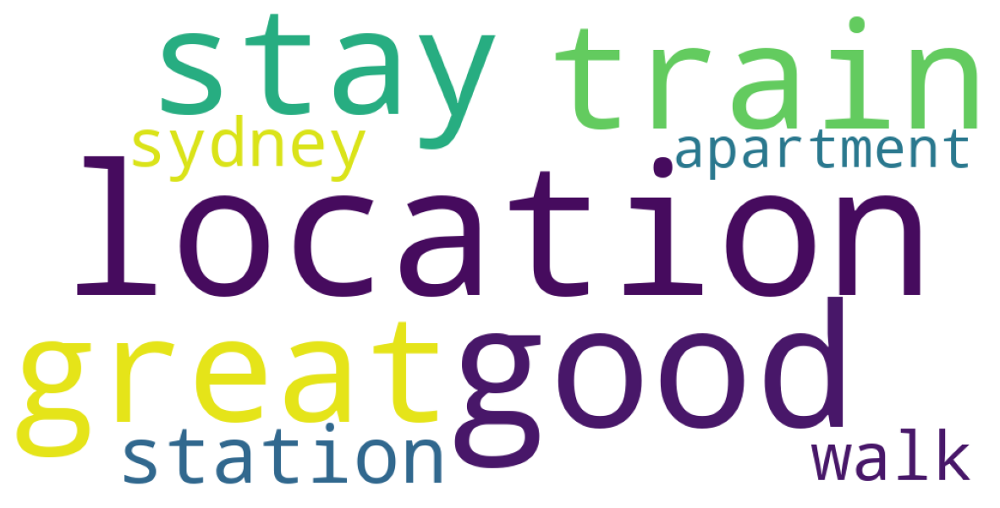

/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



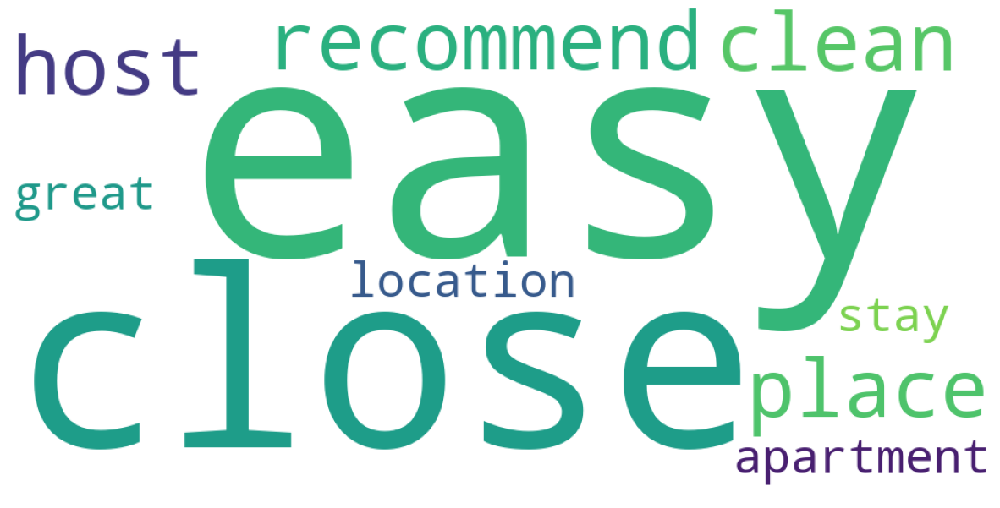

/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



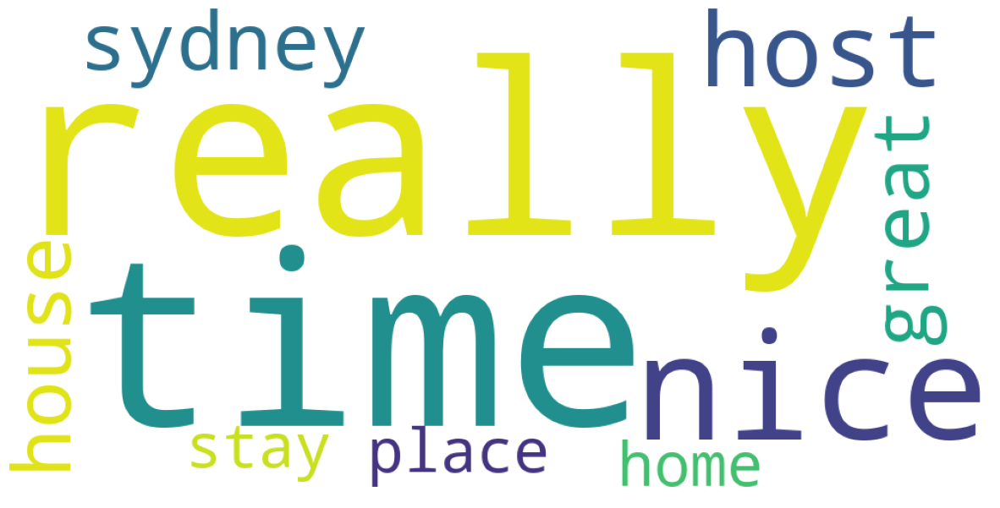

/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



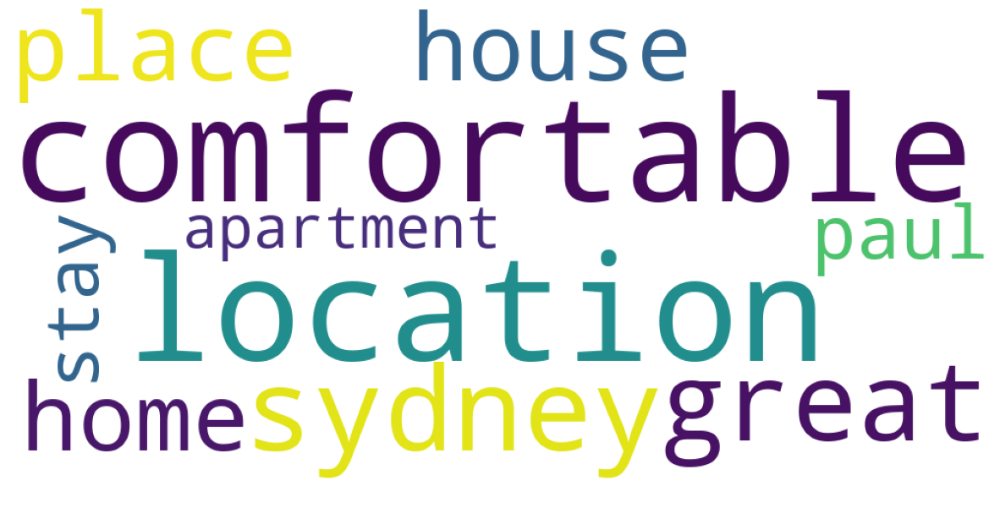

/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



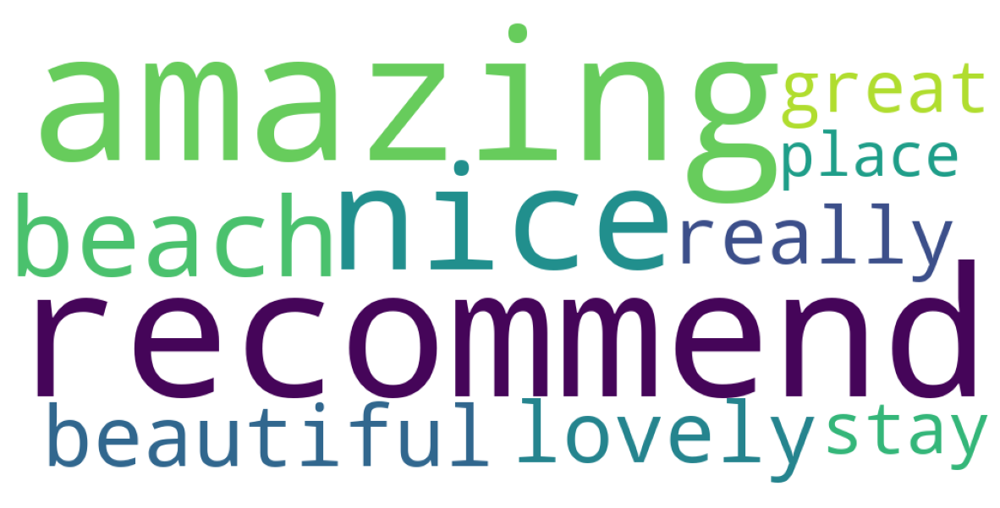

In [44]:
## Word cloud for top tpics
for i,topic in enumerate(LDA.components_):
    unique_string=(" ").join([count_vect.get_feature_names()[i] for i in topic.argsort()[-10:]])
    wordcloud = WordCloud(width = 1000, height = 500, background_color="white").generate(unique_string)
    plt.figure(figsize=(15,8))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.savefig("your_file_name"+".png", bbox_inches='tight')
    plt.show()
    plt.close()

In [45]:
reviews_datasets['Topic'] = topic_values.argmax(axis=1)

In [46]:
reviews_datasets.head()

,Unnamed: 0,listing_id,id,date,reviewer_id,reviewer_name,comments,Topic
0,0,11156.0,19220.0,2009-12-05,52946.0,Jeff,Colleen was friendly and very helpful regardin...,0
1,1,11156.0,32592.0,2010-03-31,99382.0,Michael,"Great place, centrally located, easy walk to t...",0
2,2,11156.0,42280.0,2010-05-14,105797.0,Marina,Colleen is very friendly and helpful. The apar...,1
3,3,11156.0,140942.0,2010-11-17,259213.0,Sigrid,Dear Colleen!\r\nMy friend Diemut from Germany...,2
4,4,11156.0,151966.0,2010-12-11,273389.0,Eduardo,"Lovely, interesting chats and very helpful giv...",2


In [47]:
reviews_datasets.to_csv("reviews_topic(lda).csv")

# Non-Negative Matrix Factorization (NMF)

Non-negative matrix factorization is also a supervised learning technique 
which performs clustering as well as dimensionality reduction.

It can be used in combination with TF-IDF scheme to perform topic modeling.

In [48]:
dataset = 'refined.csv'
reviews_datasets = pd.read_csv(dataset)
print('Before removing empty cells: ', reviews_datasets.shape)
reviews_datasets = reviews_datasets.head(20000)
reviews_datasets.dropna() # Data cleaning removing empty data values
print('After removing empty cells: ', reviews_datasets.shape)

Before removing empty cells:  (584019, 14)
After removing empty cells:  (20000, 14)


/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3508: DtypeWarning:

Columns (0,7) have mixed types.Specify dtype option on import or set low_memory=False.



In [49]:
# In the previous section we used thee count vectorizer, 
# but in this section we will use TFIDF vectorizer since NMF works with TFIDF. 
# We will create a document term matrix with TFIDF.

from sklearn.feature_extraction.text import TfidfVectorizer

tfidf_vect = TfidfVectorizer(max_df=0.8, min_df=2, stop_words='english')
doc_term_matrix = tfidf_vect.fit_transform(reviews_datasets['comments'].values.astype('U'))

In [50]:
from sklearn.decomposition import NMF

nmf = NMF(n_components=5, random_state=42)
nmf.fit(doc_term_matrix )

/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning:

The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).



NMF(n_components=5, random_state=42)

In [51]:
# 10 Random words from the vocubulary

import random

for i in range(10):
    random_id = random.randint(0,len(tfidf_vect.get_feature_names()))
    print(tfidf_vect.get_feature_names()[random_id])

jimmy
dubrovnik
renwick
negotiate
wares
head
stranger
boogie
responses
blocked


/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



In [52]:
# Retrieve the probability vector of words for the first topic and will retrieve the indexes of 
# the ten words with the highest probabilities

first_topic = nmf.components_[0]
top_topic_words = first_topic.argsort()[-10:]

for i in top_topic_words:
    print(tfidf_vect.get_feature_names()[i])

perfect
paul
restaurants
sydney
bondi
easy
close
beach
walk
apartment


In [53]:
for i,topic in enumerate(nmf.components_):
    print(f'Top 10 words for topic #{i}:')
    print([tfidf_vect.get_feature_names()[i] for i in topic.argsort()[-10:]])
    print('\n')

Top 10 words for topic #0:
['perfect', 'paul', 'restaurants', 'sydney', 'bondi', 'easy', 'close', 'beach', 'walk', 'apartment']


Top 10 words for topic #1:
['space', 'thanks', 'value', 'excellent', 'fantastic', 'communication', 'hosts', 'host', 'location', 'great']


Top 10 words for topic #2:
['great', 'clean', 'recommended', 'close', 'definitely', 'amazing', 'highly', 'recommend', 'stay', 'place']


Top 10 words for topic #3:
['friendly', 'quiet', 'room', 'host', 'clean', 'house', 'location', 'really', 'good', 'nice']


Top 10 words for topic #4:
['wonderful', 'time', 'hosts', 'beautiful', 'sydney', 'friendly', 'stay', 'house', 'lovely', 'home']




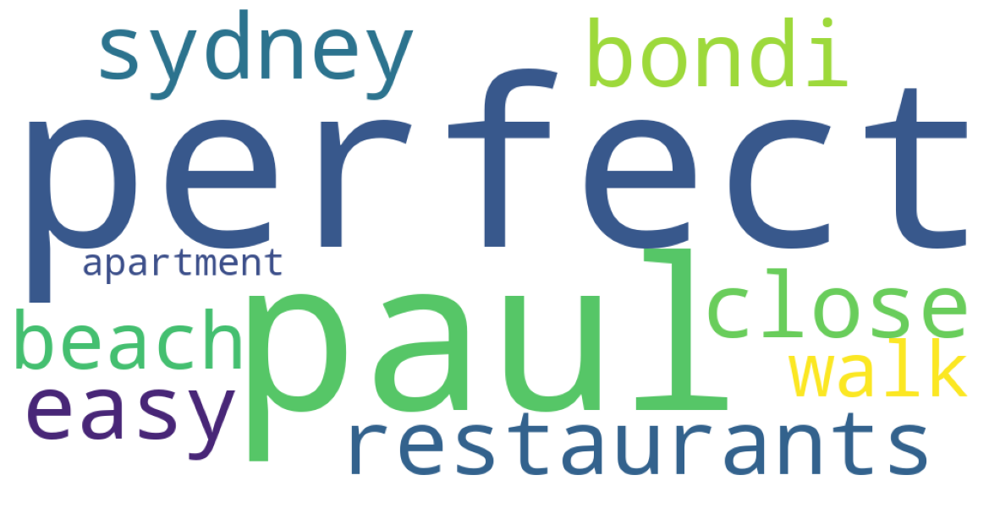

/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



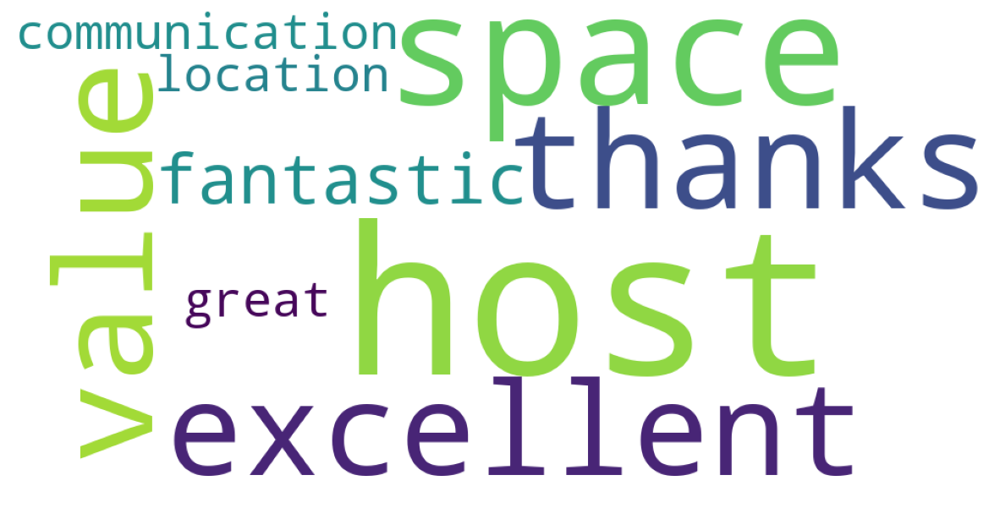

/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



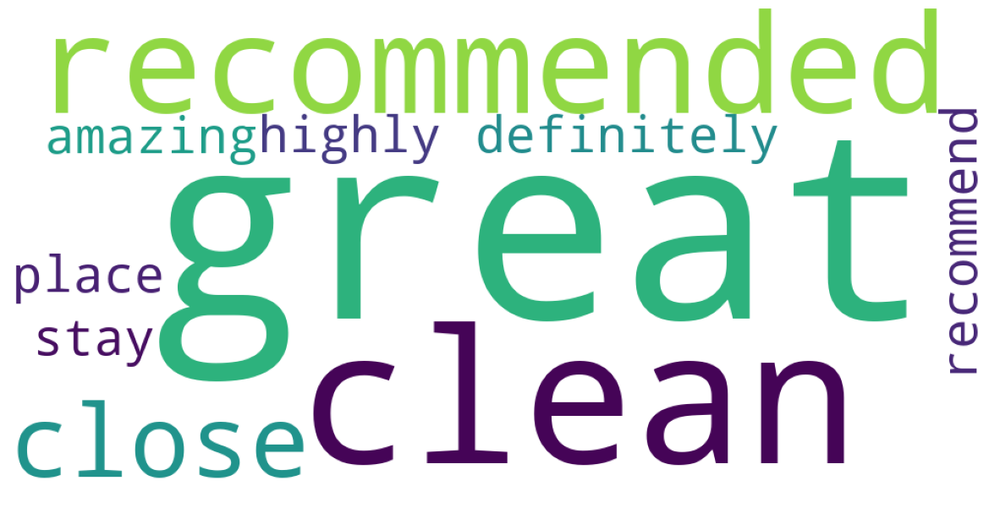

/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



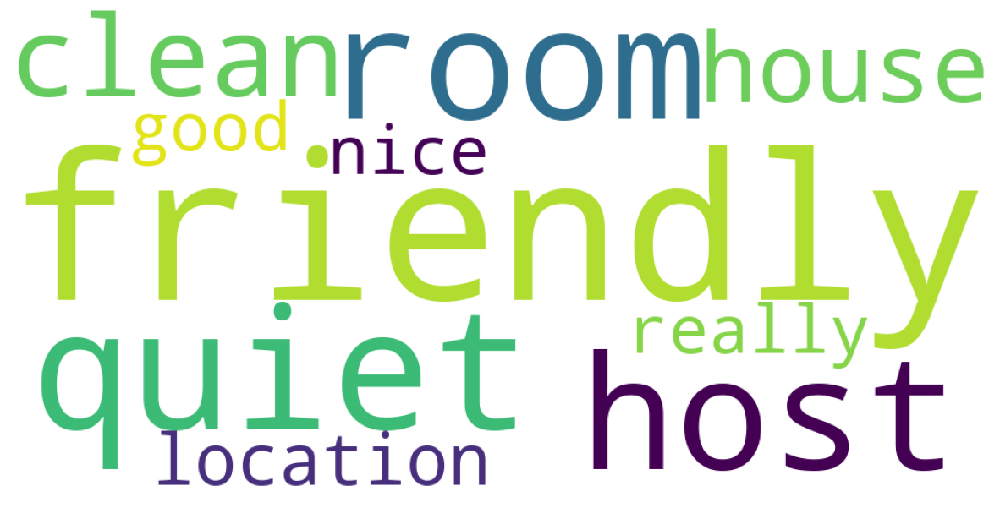

/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



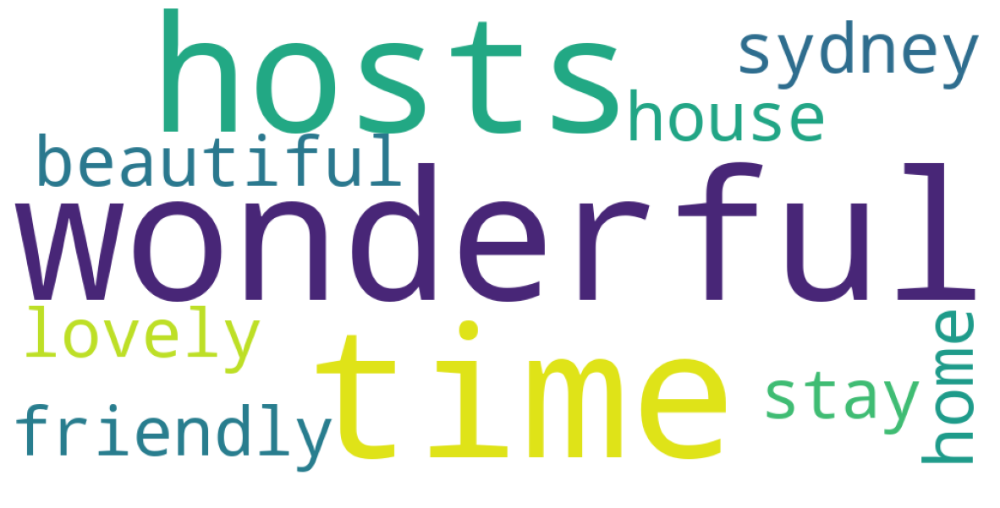

In [54]:
for i,topic in enumerate(nmf.components_):
    unique_string=(" ").join([count_vect.get_feature_names()[i] for i in topic.argsort()[-10:]])
    wordcloud = WordCloud(width = 1000, height = 500, background_color="white").generate(unique_string)
    plt.figure(figsize=(15,8))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.savefig("your_file_name"+".png", bbox_inches='tight')
    plt.show()
    plt.close()

In [55]:
topic_values = nmf.transform(doc_term_matrix)
reviews_datasets['Topic'] = topic_values.argmax(axis=1)
reviews_datasets.head()

,Unnamed: 0,listing_id,id,date,reviewer_id,reviewer_name,comments,neg,neu,pos,compound,sentiment,lang,sentimentt,Topic
0,0,11156.0,19220.0,2009-12-05,52946.0,Jeff,Colleen was friendly and very helpful regardin...,0.0,0.814,0.186,0.9402,1.0,en,positive,0
1,1,11156.0,32592.0,2010-03-31,99382.0,Michael,"Great place, centrally located, easy walk to t...",0.0,0.595,0.405,0.9359,1.0,en,positive,0
2,2,11156.0,42280.0,2010-05-14,105797.0,Marina,Colleen is very friendly and helpful. The apar...,0.0,0.517,0.483,0.8540,1.0,en,positive,3
3,3,11156.0,140942.0,2010-11-17,259213.0,Sigrid,Dear Colleen!\r\nMy friend Diemut from Germany...,0.0,0.604,0.396,0.9831,1.0,en,positive,4
4,4,11156.0,151966.0,2010-12-11,273389.0,Eduardo,"Lovely, interesting chats and very helpful giv...",0.0,0.656,0.344,0.9282,1.0,en,positive,4


In [56]:
reviews_datasets.to_csv("reviews_topic(nmf).csv")